### NUFORC Data Analysis

This is an elementary analysis of NUFORC[0] data using pandas. Any comments would be appreciated.

In [15]:
import pandas as pd
import requests
import re
from datetime import datetime
from bs4 import BeautifulSoup
import urllib.parse
import numpy as np
import sys
import plotly.express as px

In [16]:
def load_data(url):
    res = requests.get(url)
    soup = BeautifulSoup(res.text)
    links = [link.get('href') for link in soup.findAll('a')]
    links = links[1:]

    nuforc_url = "https://nuforc.org/webreports/"
    dfs = [pd.read_html(urllib.parse.urljoin(nuforc_url, link))[0] for link in links]
    data = pd.concat(dfs)
    return data

Loading UFO data.

In [17]:
url = "https://nuforc.org/webreports/ndxloc.html"
data = load_data(url)

In [18]:
data.head(5)

,Date / Time,City,State,Country,Shape,Duration,Summary,Posted,Images
0,9/5/22 05:13,Foley,AL,USA,Rectangle,Two minutes,Non-moving rectangular row of lights,9/9/22,Yes
1,8/31/22 21:02,Hoover,AL,USA,Diamond,Approximately 25 seconds,My girlfriend and I saw a diamond shaped objec...,9/9/22,NaN
2,8/10/22 19:30,Gulf Shores,AL,USA,Light,12 to 15 minutes,"It seemed like a biggish drone except silent, ...",9/9/22,NaN
3,8/7/22 21:25,Mobile,AL,USA,Triangle,Less than 45 seconds,I was outside and looked up and saw a triangul...,9/9/22,NaN
4,7/29/22 04:50,Mobile,AL,USA,Light,45 min,Shape shifting white star like orb appears and...,9/9/22,Yes


In [46]:
print(f"Dataset size: {data.shape[0]}")

Dataset size: 139526


### Shape

In [19]:
data.Shape.value_counts()[:20]

Light        28122
Circle       14814
Triangle     12468
Fireball      9614
Other         9525
Unknown       9474
Sphere        9083
Disk          8249
Oval          6033
Formation     4622
Changing      3528
Cigar         3482
Rectangle     2411
Flash         2375
Cylinder      2239
Diamond       2008
Chevron       1606
Egg           1198
Teardrop      1191
Cone           558
Name: Shape, dtype: int64

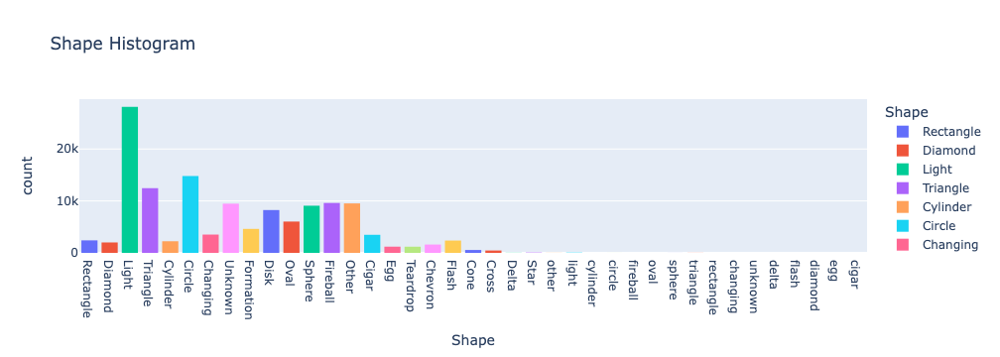

In [20]:
fig = px.histogram(data, x="Shape", color="Shape", title="Shape Histogram")
fig.show()

In [47]:
light_percentage = data.Shape.value_counts()['Light']/data.Shape.value_counts().sum()*100
triangle_percentage = data.Shape.value_counts()['Triangle']/data.Shape.value_counts().sum()*100
circle_percentage = data.Shape.value_counts()['Circle']/data.Shape.value_counts().sum()*100
disk_percentage = data.Shape.value_counts()['Disk']/data.Shape.value_counts().sum()*100
print(f"Percentage that are disks {disk_percentage:.2f}%")
print(f"Percentage that are circles {circle_percentage:.2f}%")
print(f"Percentage that are triangles {triangle_percentage:.2f}%")
print(f"Percentage that are lights {light_percentage:.2f}%")

Percentage that are disks 6.19%
Percentage that are circles 11.11%
Percentage that are triangles 9.35%
Percentage that are lights 21.10%


Not surprisingly, lights seem to be the most common recorded formation along with triangles and circles. In most sightings the object is too far away to be clearly identified as a shape and so naturally a light would be the most common shape. They could also be star-misidentifications if they are a light and so determining if there is any movement would be useful. The classic flying saucer shape as a disk is actually quite rare relative to the other shapes with only 6% that are disks. The triangle shape is only slightly more common at 10%. Indicative of rumored military aircraft like the TR-3B or possibly an advanced aircraft.

### Country

In [56]:
topten_country = pd.DataFrame(data.Country.value_counts()[:10]).rename(columns={"Country": "Count"})
topten_country

,Count
USA,124798
Canada,5128
United Kingdom,3110
Australia,885
India,433
Mexico,386
Germany,197
New Zealand,194
South Africa,188
Puerto Rico,181


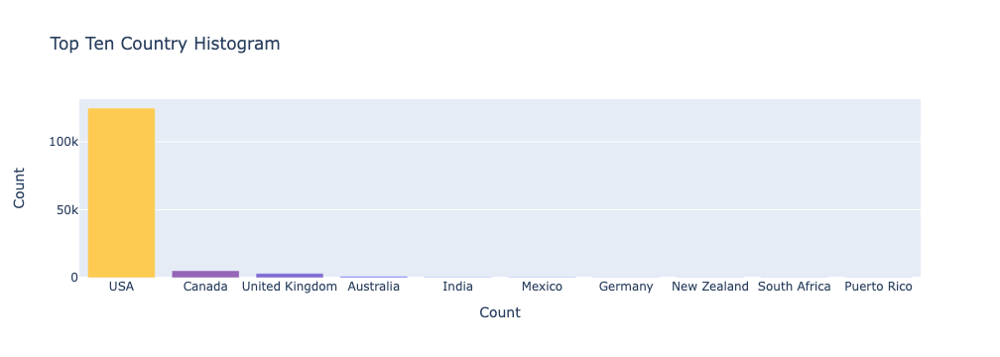

In [58]:
fig = px.bar(
    topten_country,
    y="Count",
    title="Top Ten Country Histogram",
    labels={"index": "Count"},
    color=topten_country["Count"],
    color_continuous_scale=px.colors.qualitative.Plotly)
fig.update(layout_coloraxis_showscale=False)
fig.show()

The United States has the most reports by far. I think this has more to do with NUFORC as an American based organization and mostly only well-known in the United States as well as it being an english speaking organization. Most of the reports are in english and it seems to be more friendly to users from anglophone countries. There is are also cultural tendencies to identify objects in the sky as technological rather than religious in western nations and that might also explain the discrepency. There are many [reports from around the world](https://www.artangel.org.uk/witness/ufo-sightings-from-around-world/) and I doubt UFOs are specific to the U.S.

### State

In [22]:
topten_state = pd.DataFrame(data.State.value_counts()[:10]).rename(columns={"State": "Count"})
topten_state

,Count
CA,15410
FL,7752
WA,6869
TX,5790
NY,5594
PA,4734
AZ,4722
OH,4239
IL,4106
MI,3471


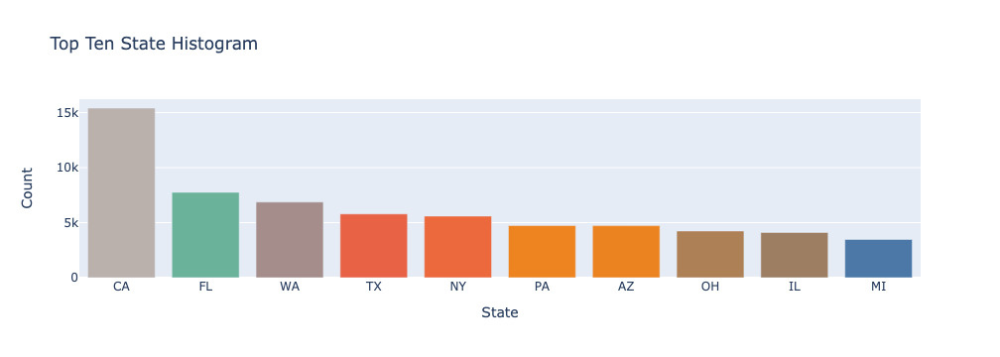

In [23]:
fig = px.bar(
    topten_state,
    y="Count",
    title="Top Ten State Histogram",
    labels={"index": "State"},
    color=topten_state["Count"],
    color_continuous_scale=px.colors.qualitative.T10)
fig.update(layout_coloraxis_showscale=False)
fig.show()

The top state is California followed by Florida and Washington. The top states of CA, NY, and TX tend to be very heavily populated states so its no surprise that less populated states which still have many sightings like NV would be lower. State distribution tends to follow along population except for WA.

### City

In [24]:
topten_city = pd.DataFrame(data.City.value_counts()[:10]).rename(columns={"City": "Count"})
topten_city

,Count
Phoenix,757
Seattle,722
Portland,626
Las Vegas,624
Los Angeles,525
San Diego,525
Tucson,435
Houston,424
Chicago,424
Albuquerque,383


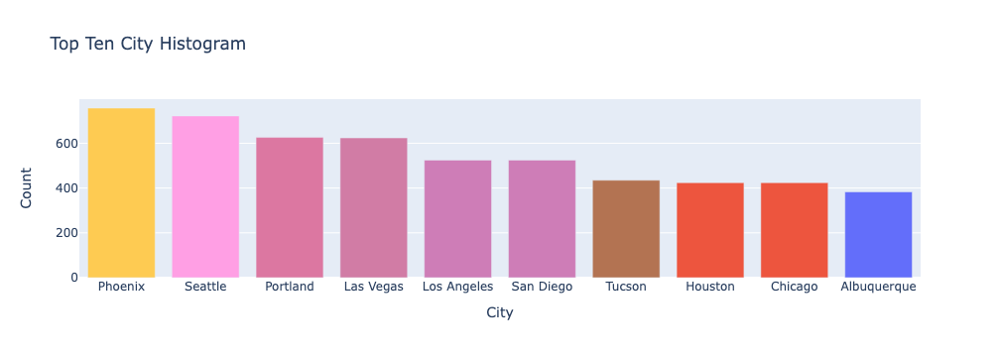

In [25]:
fig = px.bar(topten_city, y="Count",
             title="Top Ten City Histogram",
             labels={"index": "City"},
             color=topten_city["Count"],
             color_continuous_scale=px.colors.qualitative.Plotly
            )
fig.update(layout_coloraxis_showscale=False)
fig.show()

Phoenix, the site of the famous Phoenix lights has the most sightings followed by Seattle, Portland, and Area 51 hotspot Las Vegas. Unusually most of the top cities aren't the most populated like would be expected if UFO sightings were distributed evenly by population. It could westerns are more likely to report these sightings, but I can't find a good motive for why they would. Most of the top cities are located in western states and that is interesting because most military testing and other classified activity occurs in those areas as well. I suspect most secretive military spacecraft or non-terrestrial spacecraft would be flown from military bases in the western United States. Also there are many purported secretive testing facilities here: Groom Lake, S4, Tonopah.

### Duration

In [26]:
data.Duration.value_counts()[:20]

5 minutes      8487
2 minutes      6192
10 minutes     5981
1 minute       5314
3 minutes      4554
30 seconds     3782
15 minutes     3610
10 seconds     3243
5 seconds      2843
20 minutes     2660
30 minutes     2433
1 hour         2163
15 seconds     1952
20 seconds     1849
4 minutes      1610
3 seconds      1513
2 seconds      1176
2 hours        1067
2-3 minutes    1013
45 seconds      876
Name: Duration, dtype: int64

We can see that durations between 1-10 minutes seem to the most common. With durations under a minute or longer than 10, as less common.

We can correlate with population data to determine if population has an affect on whether objects are seen. https://www.texas-demographics.com/cities_by_population. By observing this pearson coefficient we can see that the population and the number of sightings are highly correlated.

### Date

When plotting by sighting date, we see some sudden jumps that correspond to holidays like 4th of July when there's fireworks. 
Disregarding that, there seems to be periodic increases during certain times of the year that aren't accounted for by holidays or seasons. In fact the peaks seem to sometimes correspond with months where there is the least activity which is confusing.

Vallee has discussed the fact that UFO occurrences seem to occur at certain times and then decline in frequency like a reinforcement system [2]. The data here seems to support that conclusion, at least on a limited time scale. The time series data seems to look like a kind of noise and understanding what type of noise might give more insight including denoising techniques.
A better analysis would cover many more years and have data for the entire United States. NUFORC's data doesn't cover much for years before 1970 so another dataset would be needed as well.

In [27]:
def strip_date(s):
    try:
        st = s.split()[0]
    except Exception:
        st = ""
    return st

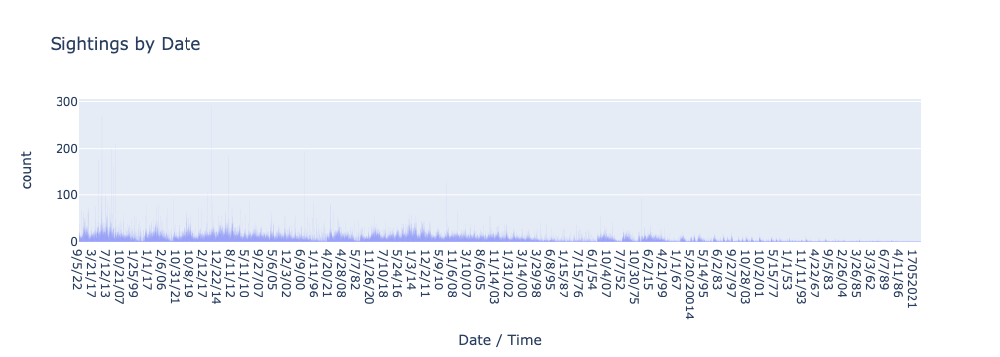

In [28]:
data_date = data.copy()
data_date['Date / Time'] = data_date['Date / Time'].apply(strip_date)

fig = px.histogram(data_date, 
                   x="Date / Time", 
                   title="Sightings by Date")
fig.update_layout(bargap=0.25)
fig.show()

If we plot the Posted label which identifies when the post was made we see a pattern where there were a jump in postings from 2019 to 2020 and 2005 to 2010.

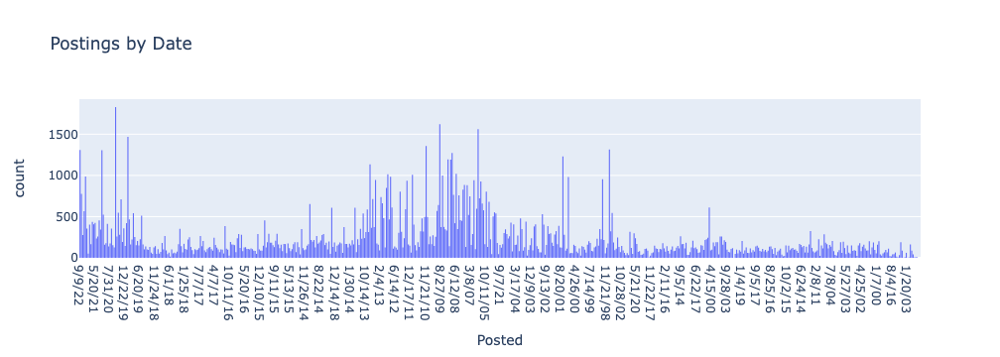

In [29]:
fig = px.histogram(data_date, x="Posted", title="Postings by Date")
fig.show()

There is a significant difference in the pattern between when the sightings occurs and when it is posted. This could either be because the date / time recorded is inaccurate or there is a delay between when the sightings happens and the recording is made. Further questioning of the data may give better answers.

### By Year

In [30]:
date_re = r"(\d+)\/(\d+)\/(\d{2})"
def to_year(s):
    res = re.search(date_re, s)
    if res is not None:
        year = res.group(3)
        if int(year) >= 0 and int(year) <= 22:
            year = '20' + year
        else:
            year = '19' + year
        return year
    return None

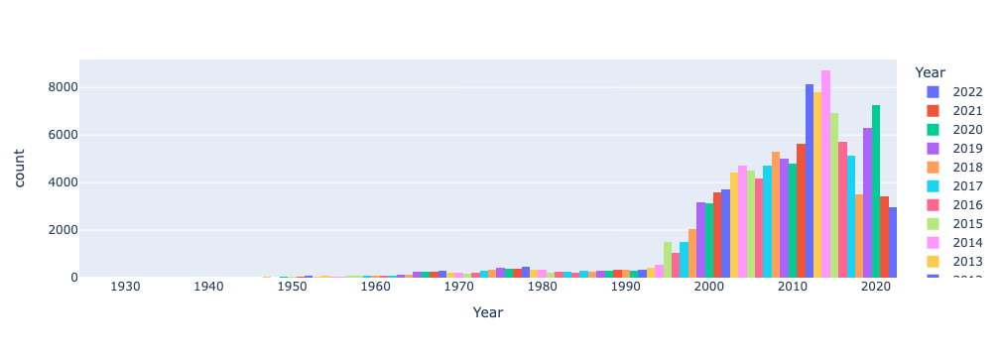

In [31]:
years = data_date['Date / Time'].dropna().apply(to_year).dropna().astype(int)
px.histogram(years, color="value", labels={'value': 'Year'}, color_discrete_sequence=px.colors.qualitative.Plotly)

If we look at the year histogram we see a marked increase around 2014 and then a decline until the year 2022 with a slight increase around 2020. The lack of sightings before the 2000s corresponds to the rise of the internet and the ability to record sightings online. A survey of data from blue book and other times prior to the 2000s would give more information.

### By Month

In [32]:
date_re = r"(\d+)\/(\d+)\/(\d{2})"
def to_month(s):
    res = re.search(date_re, s)
    if res is not None:
        month = int(res.group(1))
        if month >= 1 and month <= 12:
            return datetime(1900, month, 1).strftime("%B")
    return None

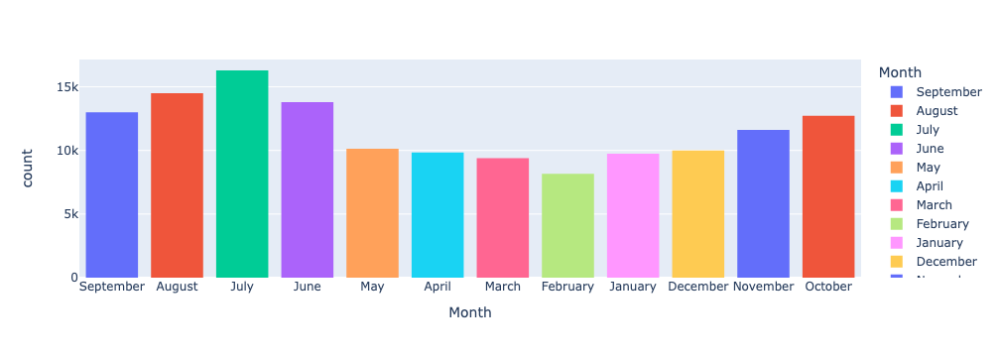

In [33]:
months = data_date['Date / Time'].dropna().apply(to_month)
px.histogram(months, color="value", labels={'value': 'Month'})

There seems to be a dip around spring with a higher concentration in summer and fall. Overall the most sightings occur in July, and June. This could be because there are more outside events during the summer and because of 4th of July where misidentification of fireworks occurs.  Why the spring months have the least is surprising and warrants further investigation.

### By Time

In [53]:
time_regex = r"\s*\d+\/\d+\/\d{2}\s+(\d{2}:\d{2})\s*"
def strip_time(s):
    try:
        res = re.search(time_regex, s)
        return res.group(1)
    except Exception:
        return None

In [54]:
data_time = data.copy()
data_time['Date / Time'] = data_time['Date / Time'].apply(strip_time)
data_time = data_time.rename(columns={"Date / Time": "Time"})
data_time.head(10)

,Time,City,State,Country,Shape,Duration,Summary,Posted,Images
0,01:20,Cordova,AL,USA,Light,10 min,Bright object with light ring trailing it,6/22/22,Yes
1,20:35,Guntersville,AL,USA,Light,About 70 minutes,A sphere/ball of light hovering above the water.,6/22/22,Yes
2,13:42,Montgomery,AL,USA,Cylinder,Probably 20-25 mins,In a telescope it looked like a purplish pink ...,6/22/22,Yes
3,21:30,TRUSSVILLE,AL,USA,Light,8-10 seconds,Three lights moving across the sky,6/22/22,NaN
4,02:00,"Cold Bluff, Alabama",AL,USA,Changing,Unbleiveabla,Terrifying,6/22/22,NaN
5,15:45,Dothan,AL,USA,NaN,NaN,MADAR Node 195,6/22/22,NaN
6,03:38,Cullman,AL,USA,Unknown,Currently Happening,UFO was seemingly bouncing and flashing in...,6/22/22,NaN
7,03:40,Opelika,AL,USA,Formation,2-3 seconds,Three orbs rotating flying through the sky,6/22/22,NaN
8,13:44,Dothan,AL,USA,NaN,NaN,MADAR Node 195,6/22/22,NaN
9,06:50,Dothan,AL,USA,NaN,NaN,MADAR Node 195,6/22/22,NaN


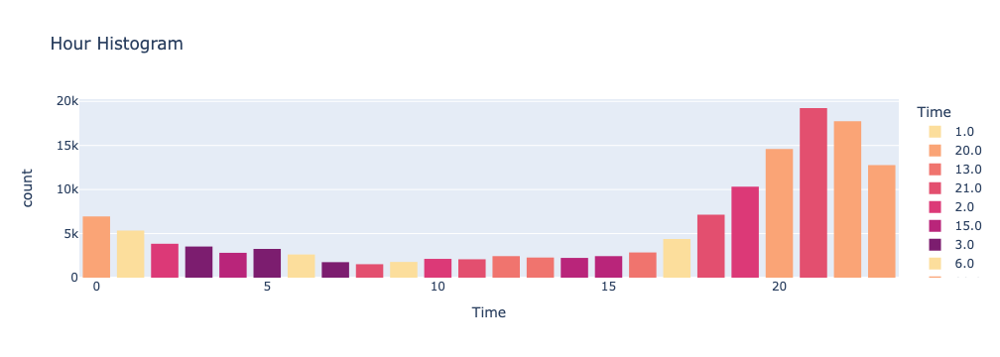

In [55]:
fig = px.histogram(
    data_time['Time'].apply(lambda s: int(s.split(':')[0]) if s is not None else None),
    x="Time",
    title="Hour Histogram",
    color="Time",
    color_discrete_sequence=px.colors.sequential.Sunsetdark)

fig.update_layout(bargap=0.2)

Nightime after sunset is when most sightings occur, right around 9pm. Which makes sense since most objects are difficult to detect during the day. A low around 8am is common for the morning hours where few sightings occur.

### Map

In [62]:
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_us_cities.csv')
df['name'] = df.name.str.strip()
map_data = data[data['Country']=='USA']
city_count = map_data.City.value_counts().rename_axis('name').reset_index(name='count')
city_count.head(10)

,name,count
0,Phoenix,757
1,Seattle,722
2,Portland,626
3,Las Vegas,624
4,Los Angeles,525
5,San Diego,525
6,Tucson,435
7,Chicago,423
8,Houston,422
9,Albuquerque,383


In [63]:
df = df.merge(city_count, how='inner', on='name')
df.head(10)

,name,pop,lat,lon,count
0,New York,8287238,40.730599,-73.986581,58
1,Los Angeles,3826423,34.053717,-118.242727,525
2,Chicago,2705627,41.875555,-87.624421,423
3,Houston,2129784,29.758938,-95.367697,422
4,Philadelphia,1539313,39.952335,-75.163789,214
5,Philadelphia,7482,39.952335,-75.163789,214
6,Phoenix,1465114,33.446768,-112.075672,757
7,San Antonio,1359174,29.424600,-98.495141,271
8,San Diego,1321016,32.717421,-117.162771,525
9,Dallas,1219399,32.776196,-96.796899,252


We can determine the correlation with population and count for each city to see how correlated population is with frequency of sightings.

In [64]:
df.corr()

,pop,lat,lon,count
pop,1.000000,-0.037002,-0.026626,0.335246
lat,-0.037002,1.000000,-0.035301,0.007503
lon,-0.026626,-0.035301,1.000000,-0.043587
count,0.335246,0.007503,-0.043587,1.000000


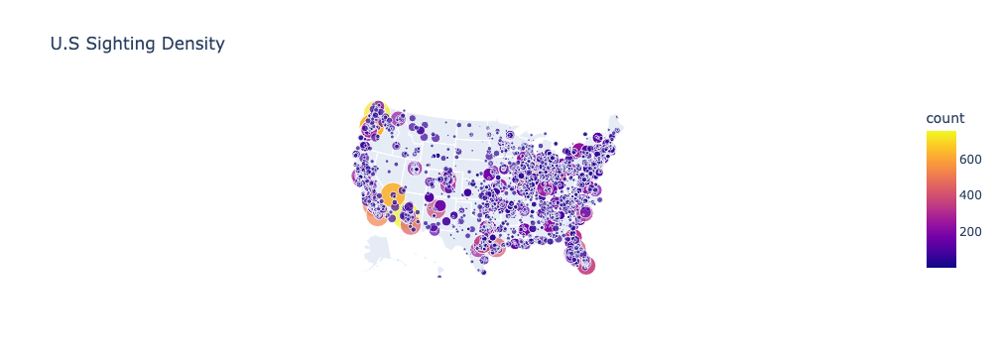

In [95]:
fig = px.scatter_geo(df, 
                     title="U.S Sighting Density",
                     lat="lat", 
                     lon="lon", 
                     hover_name="name", 
                     color="count", 
                     size="count",
                     projection="albers usa", 
                     locationmode="ISO-3")
fig.show()

I was curious to determine whether the western or eastern half of the United States had more sightings and what percentage made it up. So I divided the country by the 100W meridian and counted the number of sightings east and west of the divide. The minority of sightings approximately 26% are in the west. However, this is likely due to the lower population and if the west were equally as populated would have many more sightings since the major urban hotspots are on the west. The eastern United States has a populated rural landscape compared to the west which is mostly barren with a few small towns and little agriculture meaning fewer rural sightings. A comparison here would be interesting if I compared with population size.

In [93]:
western_count = df[df['lon'] < -100.0].shape[0]
eastern_count = df[df['lon'] > -100.0].shape[0]
print(f"West of divide: {western_count} - {100*western_count/df.shape[0]:.2f}%")
print(f"East of divide: {eastern_count} - {100*eastern_count/df.shape[0]:.2f}%")

West of divide: 775 - 26.77%
East of divide: 2120 - 73.23%


### Conclusion

The analysis here is rudimentary in that I just used basic statistics. Furthering it using machine learning or advanced techniques like clustering or time series analysis might obtain further insight. In terms of the possible number of unidentified. Even if we assume that approximately 5% of sightings are true unknowns as blue book determined for its cases [3]. That still leaves nearly 6910 unknowns. This is only reported data, which means the reporter has to know about NUFORC and be willing to post. There are usually many more unreported sightings.

In [59]:
num_possible_unknowns = int(data.shape[0]*0.05)
print(f"Num sightings: {data.shape[0]}")
print(f"Num possible unknowns: {num_possible_unknowns}")

Num sightings: 138219
Num possible unknowns: 6910


[1] National UFO Reporting Center, 11-May-2022. [Online]. Available: https://nuforc.org/. [Accessed: 09-Sep-2022]. 

[2] J. Vallee, Messengers of deception: UFO contacts and Cults. Brisbane, Australia: Daily Grail Publishing, 2008. 

[3] “Project Blue Book - Unidentified Flying Objects,” National Archives and Records Administration. [Online]. Available: https://www.archives.gov/research/military/air-force/ufos. [Accessed: 09-Sep-2022]. 